In [1]:
from astropy.table import Table
import matplotlib.pyplot as plt
import numpy as np
from knn_colors import knn_fit, getTrueY

In [2]:
unp = Table.read("unperturbed_mags.fits")

In [3]:
unp.info

<Table length=698211>
       name         dtype  unit    class     n_bad
------------------ ------- ---- ------------ -----
                ID   int64      MaskedColumn     0
                RA float64  deg       Column     0
               DEC float64  deg       Column     0
        ID_CLASSIC   int64      MaskedColumn     1
            photoz float64            Column     0
           lp_type   int64      MaskedColumn     0
         lp_NbFilt   int64      MaskedColumn     0
             lp_zq float64            Column     0
          lp_model   int64      MaskedColumn     0
            lp_age float64            Column     0
           lp_dust float64            Column     0
    lp_Attenuation   int64      MaskedColumn     0
       lp_mass_med float64            Column     0
      lp_mass_best float64            Column     0
        lp_SFR_med float64            Column     0
       lp_SFR_best float64      MaskedColumn   511
       lp_sSFR_med float64      MaskedColumn    23
      lp_

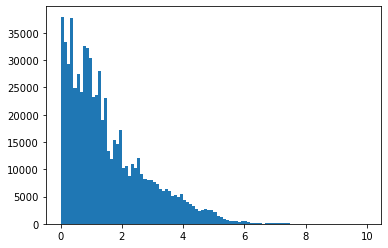

In [4]:
plt.hist(unp["photoz"], bins=100)
plt.show()

In [5]:
mock = Table.read("ext_phot.fits")
mask = unp["Euclid_VIS_MAG"] <= 24.5

In [6]:
np.sum(np.isnan(unp['LSST_u_MAG']))

0

In [7]:
# lets do some photo-z fitting using knn method
# use unperturbed catalog as training set
# split in half so half the objects are for training, and half for test

train = unp[mask]
test = mock[mask]

rng = np.random.default_rng(seed=42)
random_ids = np.arange(len(train))
rng.shuffle(random_ids)
split_dex = int(len(train) / 2)

train = train[random_ids[0:split_dex]]
test = test[random_ids[split_dex:]]

print(len(test))

58221


In [8]:
np.sum(np.isnan(train['LSST_g_MAG']))
np.sum(np.isnan(train['LSST_r_MAG']))
np.sum(np.isnan(train['LSST_i_MAG']))
np.sum(np.isnan(train['LSST_z_MAG']))
np.sum(np.isnan(train['castor_uv_MAG']))
np.sum(np.isnan(train['castor_u_MAG']))
np.sum(np.isnan(train['castor_g_MAG']))

0

In [9]:
# LSST griz and Euclid JH
mag_columns = ["LSST_g_MAG", "LSST_r_MAG", "LSST_i_MAG", "LSST_z_MAG",
               "Euclid_J_MAG", "Euclid_H_MAG"]

estz = knn_fit(train_cat=train, test_cat=test, mag_col_names=mag_columns, y_col_name="photoz")
truez = getTrueY(test_cat=test, mag_col_names=mag_columns, y_col_name="photoz")

checking isnan in color catalog to numpy array conversion
0
0
0


In [10]:
np.sum(np.isnan(estz))

0

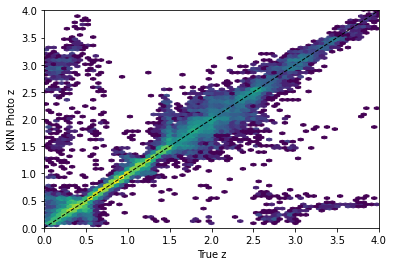

In [11]:
plt.hexbin(truez, estz, bins='log')
plt.plot([0,5], [0,5], '--', color='black', linewidth=1)
plt.ylim(0,4)
plt.xlim(0,4)
plt.xlabel("True z")
plt.ylabel("KNN Photo z")
plt.show()

In [12]:
# define photo-z summary statistics

def sigma(z_est, z_true, N):
    numerator = (z_est - z_true)
    denominator = (1+z_true)
    summand = (numerator/denominator)**2
    summed = np.sum(summand)
    return 1/N * summed

def bias(z_est, z_true, N):
    summand = (z_est - z_true)
    summed = np.sum(summand)
    return 1/N * summed

def abs_bias(z_est, z_true, N):
    summand = np.abs(z_est - z_true)
    summed = np.sum(summand)
    return 1/N * summed

In [13]:
sig = sigma(estz, truez, len(estz))

b = bias(estz, truez, len(estz))

a_b = abs_bias(estz, truez, len(estz))

In [14]:
good = np.abs(estz - truez) < 5*sig
bad = np.abs(estz - truez) > 5*sig

In [15]:
good

array([ True,  True,  True, ...,  True,  True,  True])

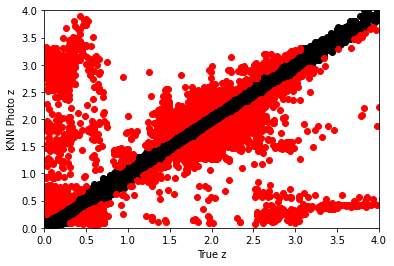

In [16]:
plt.scatter(truez[good], estz[good], color = 'k')
plt.scatter(truez[bad], estz[bad], color = 'r')

plt.plot([0,5], [0,5], '--', color='black', linewidth=1)
plt.ylim(0,4)
plt.xlim(0,4)
plt.xlabel("True z")
plt.ylabel("KNN Photo z")
plt.show()

In [17]:
np.shape(truez[good])

(54196,)

In [18]:
# LSST + CASTOR 
mag_columns_castor_LSST = ["LSST_g_MAG", "LSST_r_MAG", "LSST_i_MAG", "LSST_z_MAG",
               "castor_uv_MAG", "castor_u_MAG", "castor_g_MAG"]

estz_LSST_Castor = knn_fit(train_cat=train, test_cat=test, mag_col_names=mag_columns_castor_LSST, y_col_name="photoz")
truez_LSST_Castor = getTrueY(test_cat=test, mag_col_names=mag_columns_castor_LSST, y_col_name="photoz")

checking isnan in color catalog to numpy array conversion
0
0
0


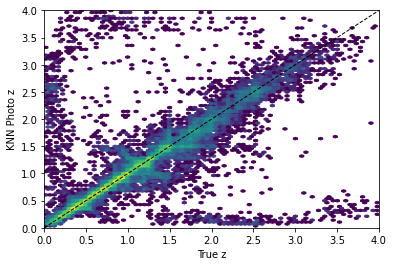

In [19]:
plt.hexbin(truez_LSST_Castor, estz_LSST_Castor, bins='log')
plt.plot([0,5], [0,5], '--', color='black', linewidth=1)
plt.ylim(0,4)
plt.xlim(0,4)
plt.xlabel("True z")
plt.ylabel("KNN Photo z")
plt.show()

In [20]:
# LSST 
mag_columns_LSST = ["LSST_g_MAG", "LSST_r_MAG", "LSST_i_MAG", "LSST_z_MAG"]

estz_LSST = knn_fit(train_cat=train, test_cat=test, mag_col_names=mag_columns_LSST, y_col_name="photoz")
truez_LSST = getTrueY(test_cat=test, mag_col_names=mag_columns_LSST, y_col_name="photoz")

checking isnan in color catalog to numpy array conversion
0
0
0


In [21]:
LSST_g_mag = getTrueY(test_cat=test, mag_col_names=mag_columns_LSST, y_col_name="LSST_g_MAG")
LSST_r_mag = getTrueY(test_cat=test, mag_col_names=mag_columns_LSST, y_col_name="LSST_r_MAG")
LSST_i_mag = getTrueY(test_cat=test, mag_col_names=mag_columns_LSST, y_col_name="LSST_i_MAG")
LSST_z_mag = getTrueY(test_cat=test, mag_col_names=mag_columns_LSST, y_col_name="LSST_z_MAG")

In [22]:
data_array_LSST = np.array([np.abs(truez_LSST - estz_LSST), LSST_g_mag, LSST_r_mag, LSST_i_mag, LSST_z_mag])

data_array_sorted_LSST = data_array_LSST.T[data_array_LSST[0,:].argsort()] # no idea why this works the way it does...

In [23]:
# now make the sorted color arrays

gminusr_LSST = data_array_sorted_LSST[:,1] - data_array_sorted_LSST[:,2]
rminusi_LSST = data_array_sorted_LSST[:,2] - data_array_sorted_LSST[:,3]
iminusz_LSST = data_array_sorted_LSST[:,3] - data_array_sorted_LSST[:,4]

In [24]:
# len(gminusr)/10

In [25]:
# gminusr[-5821:]

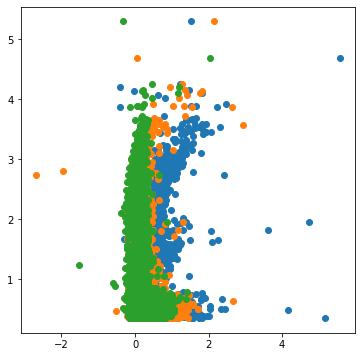

In [26]:

fig = plt.figure(figsize=(6,6))
ax = plt.subplot(111)

plt.scatter(gminusr_LSST[-5821:], data_array_sorted_LSST[-5821:, 0])
plt.scatter(rminusi_LSST[-5821:], data_array_sorted_LSST[-5821:, 0])
plt.scatter(iminusz_LSST[-5821:], data_array_sorted_LSST[-5821:, 0])

In [27]:
# fig, ax = plt.subplots(1, 2, figsize = (15,10))

# sc1 = ax[0].scatter(gminusr[-5821:],rminusi[-5821:], c=data_array_sorted[-5821:, 0], cmap=plt.cm.jet)
# # cbar = fig.colorbar(sc1, cax = ax[0], orientation='horizontal')    

# ax[0].set_xlabel('g-r', fontsize = 24)
# ax[0].set_ylabel('r-i', fontsize = 24)
# ax[0].set_title('LSST only', fontsize = 24)

# sc2 = ax[1].scatter(gminusr[-5821:],rminusi[-5821:], c=data_array_sorted[-5821:, 0], cmap=plt.cm.jet)
# # cbar = fig.colorbar(sc2, cax = ax[1], orientation='horizontal')    

# ax[1].set_xlabel('g-r', fontsize = 24)
# ax[1].set_ylabel('r-i', fontsize = 24)
# ax[1].set_title('LSST + CASTOR', fontsize = 24)

# cbar_ax = fig.add_axes([0.95, 0.15, 0.05, 0.7])

# fig.colorbar(sc1, cax=cbar_ax, label = 'Absolute Error in Inferred Redshift')

In [28]:
?plt.figure

Text(0.5, 1.0, 'LSST only')

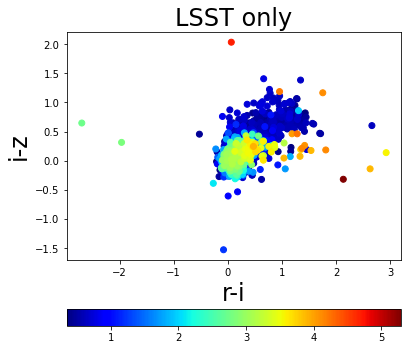

In [29]:
fig = plt.figure(figsize=(6,6))
ax = plt.subplot(111)

sc = plt.scatter(rminusi_LSST[-5821:],iminusz_LSST[-5821:], c=data_array_sorted_LSST[-5821:, 0], cmap=plt.cm.jet)
cbar = fig.colorbar(sc, orientation='horizontal')    

plt.xlabel('r-i', fontsize = 24)
plt.ylabel('i-z', fontsize = 24)
plt.title('LSST only', fontsize = 24)

In [30]:
mag_columns_castor_LSST = ["LSST_g_MAG", "LSST_r_MAG", "LSST_i_MAG", "LSST_z_MAG",
               "castor_uv_MAG", "castor_u_MAG", "castor_g_MAG"]

estz_LSST_Castor = knn_fit(train_cat=train, test_cat=test, mag_col_names=mag_columns_castor_LSST, y_col_name="photoz")
truez_LSST_Castor = getTrueY(test_cat=test, mag_col_names=mag_columns_castor_LSST, y_col_name="photoz")

LSST_g_mag_CASTOR = getTrueY(test_cat=test, mag_col_names=mag_columns_castor_LSST, y_col_name="LSST_g_MAG")
LSST_r_mag_CASTOR = getTrueY(test_cat=test, mag_col_names=mag_columns_castor_LSST, y_col_name="LSST_r_MAG")
LSST_i_mag_CASTOR = getTrueY(test_cat=test, mag_col_names=mag_columns_castor_LSST, y_col_name="LSST_i_MAG")
LSST_z_mag_CASTOR = getTrueY(test_cat=test, mag_col_names=mag_columns_castor_LSST, y_col_name="LSST_z_MAG")

checking isnan in color catalog to numpy array conversion
0
0
0


In [31]:
data_array_CASTOR = np.array([np.abs(truez_LSST_Castor - estz_LSST_Castor), LSST_g_mag_CASTOR, LSST_r_mag_CASTOR, LSST_i_mag_CASTOR, LSST_z_mag_CASTOR])

data_array_sorted_CASTOR = data_array_CASTOR.T[data_array_CASTOR[0,:].argsort()] # no idea why this works the way it does...

In [32]:
# data_array_CASTOR = np.array([np.abs(truez_LSST_Castor - estz_LSST_Castor), LSST_g_mag_CASTOR, LSST_r_mag_CASTOR, LSST_i_mag_CASTOR, LSST_z_mag_CASTOR])

# data_array_sorted_CASTOR = data_array_CASTOR.T[data_array_LSST[0,:].argsort()] # no idea why this works the way it does...

In [33]:
gminusr_CASTOR = data_array_sorted_CASTOR[:,1] - data_array_sorted_CASTOR[:,2]
rminusi_CASTOR = data_array_sorted_CASTOR[:,2] - data_array_sorted_CASTOR[:,3]
iminusz_CASTOR = data_array_sorted_CASTOR[:,3] - data_array_sorted_CASTOR[:,4]

Text(0.5, 1.0, 'LSST+CASTOR')

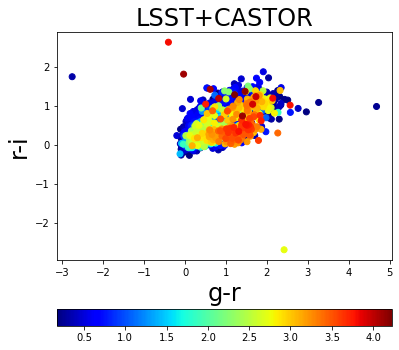

In [34]:
fig = plt.figure(figsize=(6,6))
ax = plt.subplot(111)

sc = plt.scatter(gminusr_CASTOR[-5822:],rminusi_CASTOR[-5822:], c=data_array_sorted_CASTOR[-5822:, 0], cmap=plt.cm.jet)
cbar = fig.colorbar(sc, orientation='horizontal')    

plt.xlabel('g-r', fontsize = 24)
plt.ylabel('r-i', fontsize = 24)
plt.title('LSST+CASTOR', fontsize = 24)

Text(0.5, 1.0, 'LSST + Castor')

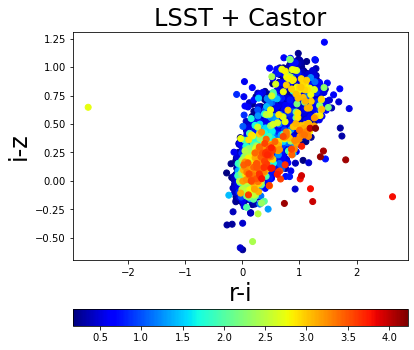

In [35]:
fig = plt.figure(figsize=(6,6))
ax = plt.subplot(111)

sc = plt.scatter(rminusi_CASTOR[-5822:],iminusz_CASTOR[-5822:], c=data_array_sorted_CASTOR[-5822:, 0], cmap=plt.cm.jet)
cbar = fig.colorbar(sc, orientation='horizontal')    

plt.xlabel('r-i', fontsize = 24)
plt.ylabel('i-z', fontsize = 24)
plt.title('LSST + Castor', fontsize = 24)

Text(0.5, 0.98, 'Top 10% in Absolute Redshift Error')

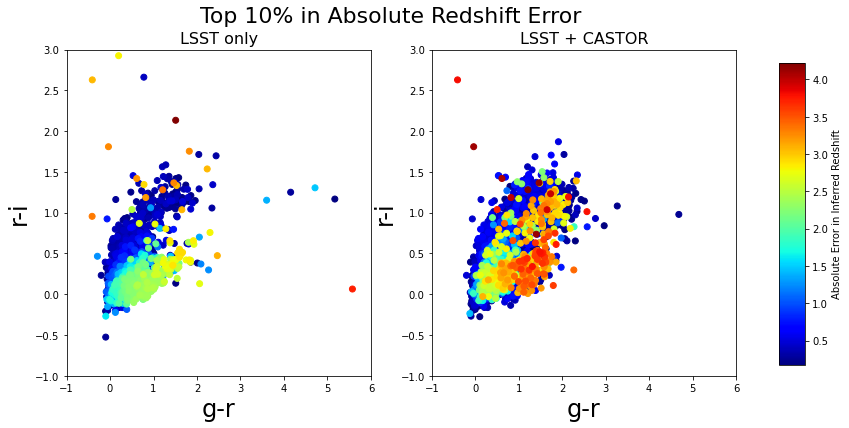

In [36]:
fig, ax = plt.subplots(1, 2, figsize = (12,6))

sc1 = ax[0].scatter(gminusr_LSST[-5821:],rminusi_LSST[-5821:], c=data_array_sorted_LSST[-5821:, 0], cmap=plt.cm.jet)
# cbar = fig.colorbar(sc1, cax = ax[0], orientation='horizontal')    

ax[0].set_xlabel('g-r', fontsize = 24)
ax[0].set_ylabel('r-i', fontsize = 24)
ax[0].set_title('LSST only', fontsize = 16)

sc2 = ax[1].scatter(gminusr_CASTOR[-5821:],rminusi_CASTOR[-5821:], c=data_array_sorted_CASTOR[-5821:, 0], cmap=plt.cm.jet)
# cbar = fig.colorbar(sc2, cax = ax[1], orientation='horizontal')    

ax[1].set_xlabel('g-r', fontsize = 24)
ax[1].set_ylabel('r-i', fontsize = 24)
ax[1].set_title('LSST + CASTOR', fontsize = 16)

ax[0].set_xlim(-1, 6)
ax[0].set_ylim(-1, 3)
ax[1].set_xlim(-1, 6)
ax[1].set_ylim(-1, 3)

cbar_ax = fig.add_axes([0.95, 0.15, 0.03, 0.7])

fig.colorbar(sc2, cax=cbar_ax, label = 'Absolute Error in Inferred Redshift')

plt.suptitle('Top 10% in Absolute Redshift Error', fontsize = 22)

In [37]:
np.average(data_array_sorted_LSST[-200:,0]) #== np.median(np.abs(estz_LSST - truez_LSST))

3.1800985

In [38]:
np.average(data_array_sorted_CASTOR[-200:,0])# == np.median(np.abs(estz_LSST_Castor - truez_LSST_Castor))

3.28358425

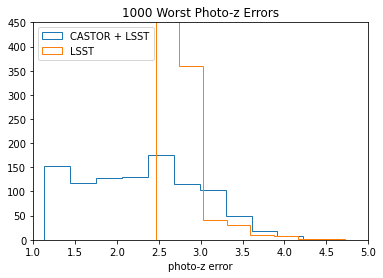

In [39]:
plt.title('1000 Worst Photo-z Errors')

plt.hist(data_array_sorted_CASTOR[-1000:,0], histtype = 'step', label = 'CASTOR + LSST')
plt.xlim(1, 5)
plt.ylim(0, 450)

plt.xlabel('photo-z error')

plt.hist(data_array_sorted_LSST[-1000:,0], histtype = 'step', label = 'LSST')
plt.xlim(1, 5)
plt.ylim(0, 450)

plt.xlabel('photo-z error')

plt.legend()

In [40]:
?plt.hist

Text(0.5, 0.98, 'Top 10% in Absolute Redshift Error')

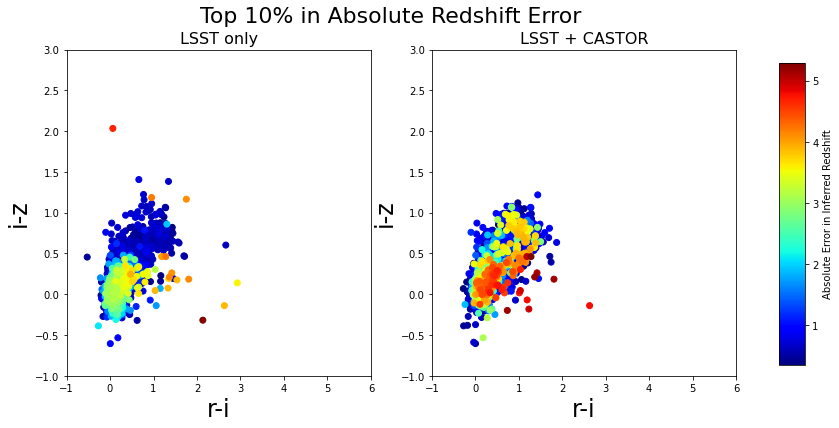

In [41]:
fig, ax = plt.subplots(1, 2, figsize = (12,6))

sc1 = ax[0].scatter(rminusi_LSST[-5821:],iminusz_LSST[-5821:], c=data_array_sorted_LSST[-5821:, 0], cmap=plt.cm.jet)
# cbar = fig.colorbar(sc1, cax = ax[0], orientation='horizontal')    

ax[0].set_xlabel('r-i', fontsize = 24)
ax[0].set_ylabel('i-z', fontsize = 24)
ax[0].set_title('LSST only', fontsize = 16)

sc2 = ax[1].scatter(rminusi_CASTOR[-5821:],iminusz_CASTOR[-5821:], c=data_array_sorted_CASTOR[-5821:, 0], cmap=plt.cm.jet)
# cbar = fig.colorbar(sc2, cax = ax[1], orientation='horizontal')    

ax[1].set_xlabel('r-i', fontsize = 24)
ax[1].set_ylabel('i-z', fontsize = 24)
ax[1].set_title('LSST + CASTOR', fontsize = 16)

ax[0].set_xlim(-1, 6)
ax[0].set_ylim(-1, 3)
ax[1].set_xlim(-1, 6)
ax[1].set_ylim(-1, 3)

cbar_ax = fig.add_axes([0.95, 0.15, 0.03, 0.7])

fig.colorbar(sc1, cax=cbar_ax, label = 'Absolute Error in Inferred Redshift')

plt.suptitle('Top 10% in Absolute Redshift Error', fontsize = 22)

In [42]:
data_array_LSST = np.array([np.abs(truez_LSST - estz_LSST), LSST_g_mag, LSST_r_mag, LSST_i_mag, LSST_z_mag, truez_LSST])

data_array_sorted_LSST = data_array_LSST.T[data_array_LSST[0,:].argsort()] # no idea why this works the way it does...

data_array_CASTOR = np.array([np.abs(truez_LSST_Castor - estz_LSST_Castor), LSST_g_mag_CASTOR, LSST_r_mag_CASTOR, LSST_i_mag_CASTOR, LSST_z_mag_CASTOR, truez_LSST_Castor])

data_array_sorted_CASTOR = data_array_CASTOR.T[data_array_CASTOR[0,:].argsort()] # no idea why this works the way it does...

In [43]:
LSST_ID = getTrueY(test_cat=test, mag_col_names=mag_columns_LSST, y_col_name="ID")
CASTOR_ID = getTrueY(test_cat=test, mag_col_names=mag_columns_castor_LSST, y_col_name="ID")

In [44]:
np.min(CASTOR_ID)

3

In [45]:
shared_values = np.intersect1d(LSST_ID, CASTOR_ID)

In [46]:
data_array_LSST_wID = np.array([LSST_ID, np.abs(truez_LSST - estz_LSST), LSST_g_mag, LSST_r_mag, LSST_i_mag, LSST_z_mag, truez_LSST])

In [47]:
data_array_sorted_LSST_wID = data_array_LSST_wID.T[data_array_LSST_wID[1,:].argsort()]

In [48]:
np.sum(np.isin(CASTOR_ID, data_array_sorted_LSST_wID[-1000:,0]))

664

In [49]:
CASTOR_ID[~np.isin(CASTOR_ID, data_array_sorted_LSST_wID[-1000:,0])]

141379
834647
106353
298328
212457
396525
248055
916464
473788
...
6014


In [50]:
data_array_CASTOR_wID = np.array([CASTOR_ID, np.abs(truez_LSST_Castor - estz_LSST_Castor), LSST_g_mag_CASTOR, LSST_r_mag_CASTOR, LSST_i_mag_CASTOR, LSST_z_mag_CASTOR, truez_LSST_Castor])

data_array_sorted_CASTOR_wID = data_array_CASTOR_wID.T[data_array_CASTOR[1,:].argsort()] # no idea why this works the way it does...

In [51]:
data_array_CASTOR_wID[0,:]

array([141379., 834647., 106353., ...,  55161., 191827., 648502.])

In [52]:
shared_data = data_array_CASTOR_wID[:, np.isin(CASTOR_ID, data_array_sorted_LSST_wID[-1000:,0])] #1000 worst

In [53]:
lost_data = data_array_LSST_wID[:, ~np.isin(data_array_sorted_LSST_wID[:,0], CASTOR_ID)]

In [54]:
gminusr_CASTOR_shared = shared_data[2,:] - shared_data[3,:]
rminusi_CASTOR_shared = shared_data[3,:] - shared_data[4,:]
iminusz_CASTOR_shared = shared_data[4,:] - shared_data[5,:]

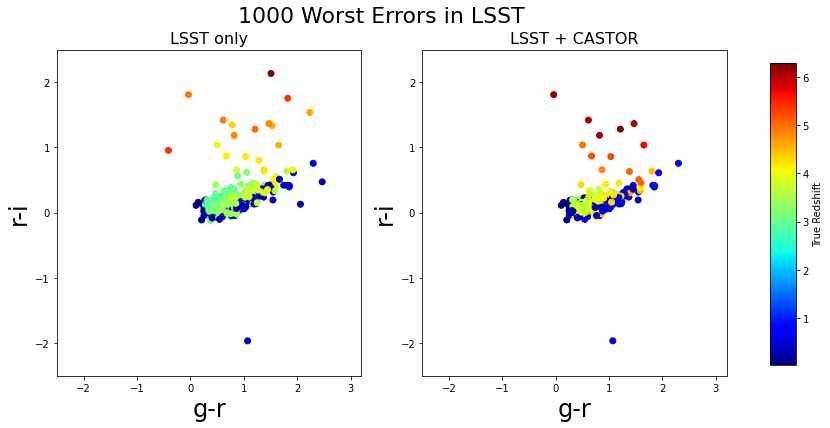

In [55]:
fig, ax = plt.subplots(1, 2, figsize = (12,6))

sc1 = ax[0].scatter(gminusr_LSST[-1000:],rminusi_LSST[-1000:], c=data_array_sorted_LSST[-1000:, 5], cmap=plt.cm.jet)

ax[0].set_xlabel('g-r', fontsize = 24)
ax[0].set_ylabel('r-i', fontsize = 24)
ax[0].set_title('LSST only', fontsize = 16)
ax[0].set_xlim(-2.5, 3.2)
ax[0].set_ylim(-2.5, 2.5)

sc2 = ax[1].scatter(gminusr_CASTOR_shared,rminusi_CASTOR_shared, c=shared_data[6,:], cmap=plt.cm.jet)
# cbar = fig.colorbar(sc1, cax = ax[0], orientation='horizontal')    

ax[1].set_xlabel('g-r', fontsize = 24)
ax[1].set_ylabel('r-i', fontsize = 24)
# ax[0].set_title('LSST only', fontsize = 16)

ax[1].set_xlim(-2.5, 3.2)
ax[1].set_ylim(-2.5, 2.5)
ax[1].set_title('LSST + CASTOR', fontsize = 16)

plt.suptitle('1000 Worst Errors in LSST', fontsize = 22)

cbar_ax = fig.add_axes([0.95, 0.15, 0.03, 0.7])

# this actually is the true redshift of the 660ish remaining worst errors

# I think the difference in color mapping is an issue with how matplotlib does colorbars... working on it. 

fig.colorbar(sc1, cax= cbar_ax, label = 'True Redshift') 

In [56]:
np.max(data_array_sorted_LSST[-1000:, 5])

6.2972

In [57]:
np.max(truez_LSST)

6.2972

In [58]:
np.max(shared_data[6,:])

5.0313

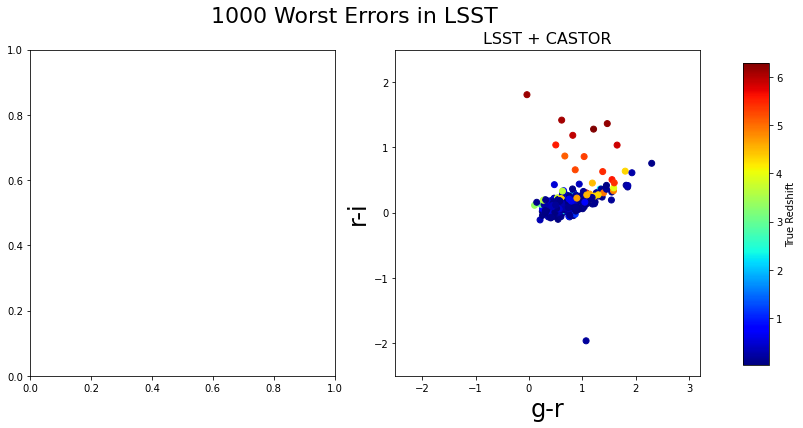

In [59]:
fig, ax = plt.subplots(1, 2, figsize = (12,6))


sc2 = ax[1].scatter(gminusr_CASTOR_shared,rminusi_CASTOR_shared, c=shared_data[1,:], cmap=plt.cm.jet)
# cbar = fig.colorbar(sc1, cax = ax[0], orientation='horizontal')    

ax[1].set_xlabel('g-r', fontsize = 24)
ax[1].set_ylabel('r-i', fontsize = 24)
# ax[0].set_title('LSST only', fontsize = 16)

ax[1].set_xlim(-2.5, 3.2)
ax[1].set_ylim(-2.5, 2.5)
ax[1].set_title('LSST + CASTOR', fontsize = 16)

plt.suptitle('1000 Worst Errors in LSST', fontsize = 22)

cbar_ax = fig.add_axes([0.95, 0.15, 0.03, 0.7])

fig.colorbar(sc1, cax=cbar_ax, label = 'True Redshift')

In [60]:
np.median(shared_data[1,:])

0.08192500000000003

In [61]:
np.median(np.abs(truez_LSST_Castor - estz_LSST_Castor))

0.02464999999999995

Text(0.5, 0.98, 'Top 10% in Absolute Redshift Error')

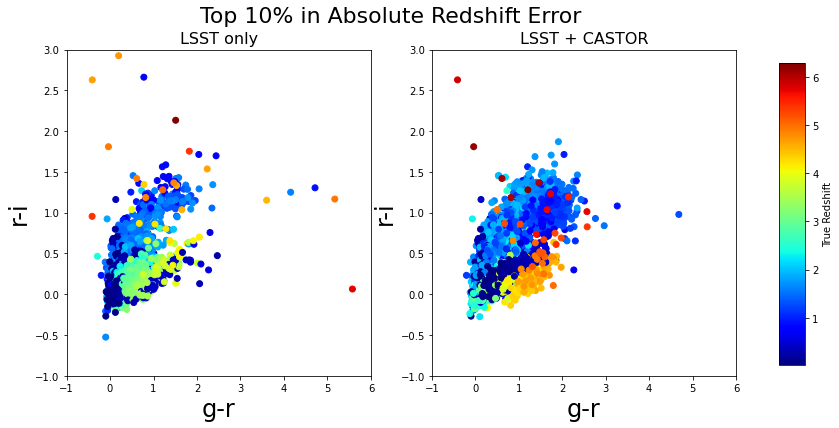

In [62]:
fig, ax = plt.subplots(1, 2, figsize = (12,6))

sc1 = ax[0].scatter(gminusr_LSST[-5821:],rminusi_LSST[-5821:], c=data_array_sorted_LSST[-5821:, 5], cmap=plt.cm.jet)
# cbar = fig.colorbar(sc1, cax = ax[0], orientation='horizontal')    

ax[0].set_xlabel('g-r', fontsize = 24)
ax[0].set_ylabel('r-i', fontsize = 24)
ax[0].set_title('LSST only', fontsize = 16)

sc2 = ax[1].scatter(gminusr_CASTOR[-5821:],rminusi_CASTOR[-5821:], c=data_array_sorted_CASTOR[-5821:, 5], cmap=plt.cm.jet)
# cbar = fig.colorbar(sc2, cax = ax[1], orientation='horizontal')    

ax[1].set_xlabel('g-r', fontsize = 24)
ax[1].set_ylabel('r-i', fontsize = 24)
ax[1].set_title('LSST + CASTOR', fontsize = 16)

ax[0].set_xlim(-1, 6)
ax[0].set_ylim(-1, 3)
ax[1].set_xlim(-1, 6)
ax[1].set_ylim(-1, 3)

cbar_ax = fig.add_axes([0.95, 0.15, 0.03, 0.7])

fig.colorbar(sc1, cax=cbar_ax, label = 'True Redshift')

plt.suptitle('Top 10% in Absolute Redshift Error', fontsize = 22)

Text(0.5, 0.98, 'Top 10% in Absolute Redshift Error')

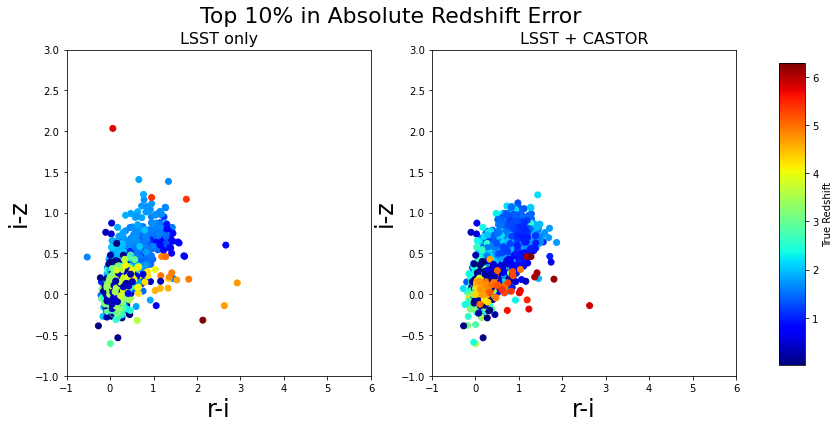

In [63]:
fig, ax = plt.subplots(1, 2, figsize = (12,6))

sc1 = ax[0].scatter(rminusi_LSST[-5821:],iminusz_LSST[-5821:], c=data_array_sorted_LSST[-5821:, 5], cmap=plt.cm.jet)
# cbar = fig.colorbar(sc1, cax = ax[0], orientation='horizontal')    

ax[0].set_xlabel('r-i', fontsize = 24)
ax[0].set_ylabel('i-z', fontsize = 24)
ax[0].set_title('LSST only', fontsize = 16)

sc2 = ax[1].scatter(rminusi_CASTOR[-5821:],iminusz_CASTOR[-5821:], c=data_array_sorted_CASTOR[-5821:, 5], cmap=plt.cm.jet)
# cbar = fig.colorbar(sc2, cax = ax[1], orientation='horizontal')    

ax[1].set_xlabel('r-i', fontsize = 24)
ax[1].set_ylabel('i-z', fontsize = 24)
ax[1].set_title('LSST + CASTOR', fontsize = 16)

ax[0].set_xlim(-1, 6)
ax[0].set_ylim(-1, 3)
ax[1].set_xlim(-1, 6)
ax[1].set_ylim(-1, 3)

cbar_ax = fig.add_axes([0.95, 0.15, 0.03, 0.7])

fig.colorbar(sc1, cax=cbar_ax, label = 'True Redshift')

plt.suptitle('Top 10% in Absolute Redshift Error', fontsize = 22)

In [64]:
import seaborn as sns 
import pandas as pd

# df = pd.read_clipboard()
#table = df.pivot('Y', 'X', 'Value')
#ax = sns.heatmap(table)
#ax.invert_yaxis()
#print(table)
#plt.show()

In [65]:
# ?plt.pcolormesh

In [66]:
#gminusr[58216]

In [67]:
np.min(LSST_g_mag)

15.390294366879992

In [68]:
np.max(np.abs(truez_LSST - estz_LSST))

5.2945

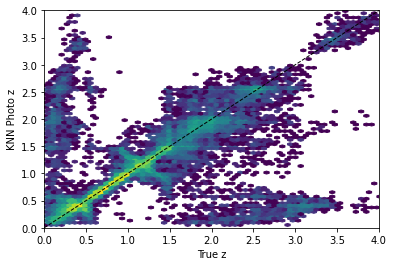

In [69]:
plt.hexbin(truez_LSST, estz_LSST, bins='log')
plt.plot([0,5], [0,5], '--', color='black', linewidth=1)
plt.ylim(0,4)
plt.xlim(0,4)
plt.xlabel("True z")
plt.ylabel("KNN Photo z")
plt.show()

In [70]:
sig = sigma(estz_LSST, truez_LSST, len(estz))

b = bias(estz_LSST, truez_LSST, len(estz))

a_b = abs_bias(estz_LSST, truez_LSST, len(estz))

print(sig, b, a_b)

0.08104474824611708 -0.02076945441739817 0.18499138938037896


In [71]:
sig = sigma(estz_LSST_Castor, truez_LSST_Castor, len(estz))

b = bias(estz_LSST_Castor, truez_LSST_Castor, len(estz))

a_b = abs_bias(estz_LSST_Castor, truez_LSST_Castor, len(estz))

print(sig, b, a_b)

0.04121352037914945 0.0008669979214264863 0.09670182347585593


In [72]:
def error(z_est, z_true, N):
    summand = np.abs(z_est - z_true)
    return summand

In [73]:
Castor_LSST_errors = np.array(error(estz_LSST_Castor, truez_LSST_Castor, len(estz)))
LSST_errors = np.array(error(estz_LSST, truez_LSST, len(estz)))

In [74]:
np.percentile(Castor_LSST_errors, [10, 20, 30, 40, 50, 60, 70, 80, 90])

array([0.00325, 0.00705, 0.0115 , 0.0172 , 0.02465, 0.03505, 0.05188,
       0.0868 , 0.1838 ])

In [75]:
from scipy.stats import percentileofscore

In [76]:
sorted_CASTOR_LSST_errors = np.sort(Castor_LSST_errors)
sorted_LSST_errors = np.sort(LSST_errors)

In [77]:
#?np.sort

In [78]:
len(estz)

58213

In [79]:
test["LSST_g_MAG"]

24.873907792253625
24.40528321825905
25.095039038723193
25.08763087666798
23.917503496437213
24.772797990330623
25.546552339809345
22.572196432302384
26.225267571447937
...
24.216276690795205


In [80]:
import astroML

In [81]:
from astroML.density_estimation import KNeighborsDensity
from astropy.visualization import hist
from sklearn.neighbors import KernelDensity


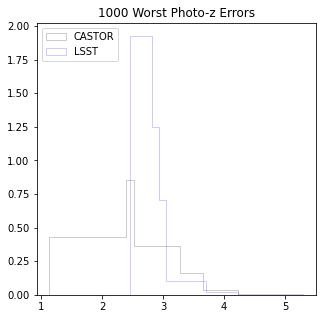

In [82]:
fig = plt.figure(figsize=(5, 5))
ax = fig.add_subplot(111)
# ax.plot(data_array_sorted_CASTOR[-100:,0])

hist(data_array_sorted_CASTOR[-1000:,0], bins='blocks', ax=ax, density=True, zorder=1,
         histtype='step', color='k', alpha=0.2,
         label="CASTOR")
hist(data_array_sorted_LSST[-1000:,0], bins='blocks', ax=ax, density=True, zorder=1,
         histtype='step', color='b', alpha=0.2,
         label="LSST")

plt.title('1000 Worst Photo-z Errors')

plt.legend()

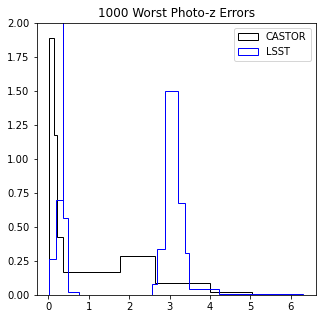

In [83]:
fig = plt.figure(figsize=(5, 5))
ax = fig.add_subplot(111)
# ax.plot(data_array_sorted_CASTOR[-100:,0])

hist(data_array_sorted_CASTOR[-1000:,5], bins='blocks', ax=ax, density=True, zorder=1,
         histtype='step', color='k',
         label="CASTOR")
hist(data_array_sorted_LSST[-1000:,5], bins='blocks', ax=ax, density=True, zorder=1,
         histtype='step', color='b',
         label="LSST")

plt.ylim(0, 2)
plt.title('1000 Worst Photo-z Errors')

plt.legend()

In [84]:
estz_LSST_Castor

array([0.75435, 2.49345, 0.9322 , ..., 0.42865, 0.39615, 0.96765])

In [85]:
estz_LSST

array([0.7506, 2.3214, 0.9842, ..., 0.4252, 0.43  , 0.9376])

(array([9.34579439e-02, 2.67377089e-01, 4.82428115e-01, 8.52760736e-01,
        3.24453280e-01, 9.01900360e-01, 1.33544806e+00, 4.83069977e-01,
        1.15555556e+00, 4.19047619e+00, 6.31459140e-01, 1.34341253e+00,
        6.95018226e-01, 1.24840764e+00, 7.42465753e-01, 1.37500000e+00,
        5.86685653e-01, 1.32844037e+00, 7.88580247e-01, 3.37500000e+00,
        8.67346939e-01, 2.76543210e+00, 9.66931217e-01, 3.73519705e-01,
        6.70030272e-01, 1.26315789e+00, 4.90912978e-01, 1.88770238e-01,
        3.51797423e-01, 8.00000000e+00, 5.13537118e-01, 1.25381298e-01,
        1.99212155e-01, 9.02596666e-02, 5.41165587e-02, 1.08944599e-01,
        3.12986262e-02, 7.75521715e-03, 2.25988701e-01, 3.21446509e-03]),
 array([0.05355 , 0.0803  , 0.183525, 0.214825, 0.231125, 0.294   ,
        0.342675, 0.3742  , 0.4185  , 0.42975 , 0.430275, 0.649925,
        0.673075, 0.69365 , 0.705425, 0.741925, 0.760325, 0.83055 ,
        0.844175, 0.908975, 0.909775, 0.929375, 0.9314  , 1.007   ,
      

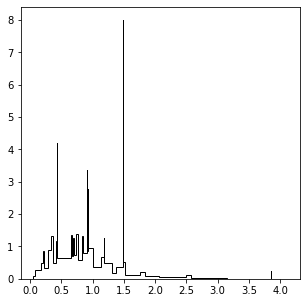

In [86]:
fig = plt.figure(figsize=(5, 5))
ax = fig.add_subplot(111)

# hist(estz_LSST[0:10000], bins='blocks', ax=ax, density=True, zorder=1,
#          histtype='step', color='b',
#          label="LSST")

hist(estz_LSST_Castor[0:10000], bins='blocks', ax=ax, density=True, zorder=1,
         histtype='step', color='k',
         label="LSST")

(array([6.98412698e-02, 3.58318099e-01, 1.90874260e-01, 4.86692015e-01,
        2.73809524e-01, 7.45967742e-01, 1.12778905e+00, 1.76923077e+00,
        5.76086957e-01, 9.40606061e-01, 2.09852217e+00, 9.60000000e+00,
        1.00000000e+02, 3.69811321e+00, 1.16062176e+00, 2.65682657e-01,
        5.66308244e-01, 1.05301645e+00, 6.61945231e-01, 1.29397294e+00,
        7.86489747e-01, 1.38033395e+00, 6.35406699e-01, 1.16400000e+00,
        5.91003460e-01, 1.17469880e+00, 7.88099575e-01, 2.68041237e+00,
        8.02555911e-01, 1.09893455e+00, 6.46017699e-01, 2.26322263e-01,
        3.94546913e-01, 8.17872754e-01, 3.31938633e-01, 6.25000000e-01,
        2.94447910e-01, 4.53547915e-01, 9.57020678e-02, 1.90150356e-01,
        8.09859155e-02, 2.97872340e-02, 5.94795539e-02, 1.66666667e-01,
        3.25222552e-01, 1.18012422e-01, 2.26021868e-02, 1.76087339e-03,
        1.17778017e-02, 7.83353733e-04]),
 array([0.05795 , 0.1052  , 0.13255 , 0.204325, 0.230625, 0.289425,
        0.339025, 0.363675

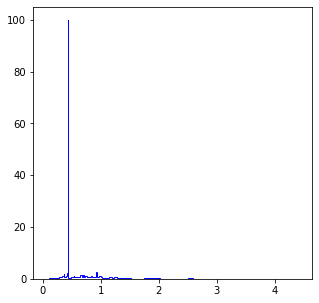

In [87]:
fig = plt.figure(figsize=(5, 5))
ax = fig.add_subplot(111)

hist(estz_LSST[0:10000], bins='blocks', ax=ax, density=True, zorder=1,
         histtype='step', color='b',
         label="LSST")

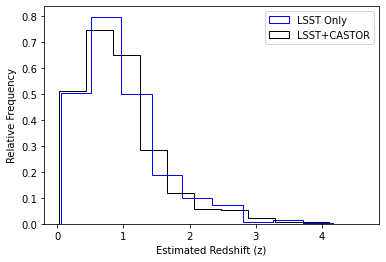

In [88]:
plt.hist(estz_LSST,density=True, zorder=1,
         histtype='step', color='b',
         label="LSST Only")

plt.hist(estz_LSST_Castor,density=True, zorder=1,
         histtype='step', color='k',
         label="LSST+CASTOR")

plt.xlabel('Estimated Redshift (z)')
plt.ylabel('Relative Frequency')

plt.legend()

In [89]:
from astropy.cosmology import WMAP9 as cosmo
cosmo.comoving_distance(np.array([0.5, 1.0, 1.5]))  

<Quantity [1916.06941724, 3363.07062107, 4451.7475201 ] Mpc>

In [90]:
np.max(estz_LSST)

4.6297

In [91]:
np.max(estz_LSST_Castor)

4.10435

In [92]:
cosmo.comoving_distance(np.array([0.0339, 4.6]))  

<Quantity [ 145.53276162, 7738.92359175] Mpc>

In [93]:
import astropy.cosmology as cosmology

In [94]:
from astropy import units as u

In [95]:
equal_comoving_bins = np.linspace(145, 7800) * u.Mpc

In [96]:
redshift_bins = cosmology.z_at_value(cosmo.comoving_distance, equal_comoving_bins)

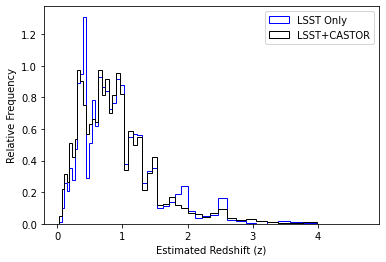

In [97]:
hist_LSST = plt.hist(estz_LSST, bins = redshift_bins, density=True, zorder=1,
         histtype='step', color='b',
         label="LSST Only")

hist_LSST_Castor = plt.hist(estz_LSST_Castor, bins = redshift_bins, density=True, zorder=1,
         histtype='step', color='k',
         label="LSST+CASTOR")

plt.xlabel('Estimated Redshift (z)')
plt.ylabel('Relative Frequency')

plt.legend()

In [98]:
hist_LSST[0]

array([1.25452771e-02, 1.00928862e-01, 2.58319583e-01, 2.08117614e-01,
       3.55804926e-01, 2.76210723e-01, 4.74352600e-01, 8.92561145e-01,
       9.49678217e-01, 1.31046489e+00, 2.89872246e-01, 5.11924964e-01,
       7.83217304e-01, 6.21363109e-01, 9.26055396e-01, 8.66402992e-01,
       8.38965973e-01, 7.25302157e-01, 7.66119442e-01, 9.14449672e-01,
       8.80835698e-01, 3.79234452e-01, 5.48978944e-01, 5.67067530e-01,
       5.61876575e-01, 2.60800912e-01, 3.33230970e-01, 3.52146795e-01,
       9.70035463e-02, 1.13535646e-01, 1.38232904e-01, 1.86805721e-01,
       2.37665933e-01, 8.10140032e-02, 3.83336265e-02, 5.17248822e-02,
       5.74804130e-02, 1.62313901e-01, 2.62119441e-02, 1.45609726e-02,
       5.28634865e-03, 1.24792712e-03, 1.11802025e-02, 1.63486322e-02,
       8.33969979e-03, 5.38495331e-03, 1.45383843e-03, 1.43304329e-03,
       1.33980760e-04])

In [99]:
from scipy.stats import moment

LSST_2 = moment(hist_LSST[0], moment=2)
LSST_3 = moment(hist_LSST[0], moment=3)
LSST_4 = moment(hist_LSST[0], moment=4)

In [100]:
LSST_2, LSST_3, LSST_4

(0.11946317492996404, 0.03305588986779182, 0.03638426026636615)

In [101]:
LSST_Castor_2 = moment(hist_LSST_Castor[0], moment=2)
LSST_Castor_3 = moment(hist_LSST_Castor[0], moment=3)
LSST_Castor_4 = moment(hist_LSST_Castor[0], moment=4)

In [102]:
LSST_Castor_2, LSST_Castor_3, LSST_Castor_4

(0.10707343071496273, 0.017475808012828144, 0.020829118976872014)

In [103]:
import plotly.express as px

In [104]:
data_array_sorted_CASTOR_wID.shape

(54469, 7)

In [105]:
# data_array_CASTOR_wID = np.array([CASTOR_ID, np.abs(truez_LSST_Castor - estz_LSST_Castor), LSST_g_mag_CASTOR, LSST_r_mag_CASTOR, LSST_i_mag_CASTOR, LSST_z_mag_CASTOR, truez_LSST_Castor])


In [106]:
import pandas as pd

In [107]:
df = pd.DataFrame({'CASTOR_ID': data_array_sorted_CASTOR_wID[:,0] , 'error': data_array_sorted_CASTOR_wID[:,1], 'g_mag': data_array_sorted_CASTOR_wID[:,2], 'r_mag': data_array_sorted_CASTOR_wID[:,3], 'i_mag': data_array_sorted_CASTOR_wID[:,4], 'z_mag': data_array_sorted_CASTOR_wID[:,5], 'true_z': data_array_sorted_CASTOR_wID[:,6]})

In [108]:
df = pd.DataFrame({'CASTOR_ID': data_array_sorted_CASTOR_wID[:,0] , 'error': data_array_sorted_CASTOR_wID[:,1], 
                   'g-r': data_array_sorted_CASTOR_wID[:,2] - data_array_sorted_CASTOR_wID[:,3], 
                   'r-i': data_array_sorted_CASTOR_wID[:,3] - data_array_sorted_CASTOR_wID[:,4], 
                   'i-z': data_array_sorted_CASTOR_wID[:,4] - data_array_sorted_CASTOR_wID[:,5], 
                   'true_z': data_array_sorted_CASTOR_wID[:,6]})

In [109]:
# fig = px.scatter(df, x = 'g-r', y = 'r-i', color = 'error', hover_data = ['i-z', 
#       'true_z', 
#       'CASTOR_ID'
#     ], marginal_x="histogram", marginal_y="histogram")
# fig.show()

In [110]:
import plotly.graph_objects as go

In [111]:
#trace_CASTOR = go.Scatter(x = df['g-r'], y = df['r-i'], mode = 'markers')
#fig = go.Figure()

# fig.add_trace(trace_CASTOR)

In [112]:
marker_dict = dict( 
        color = df['true_z'],
        opacity = 1,
        )

    # set a template for the tooltips below.  
    # hovertemplate can accept the x and y data and additional "text" as defined by a separate input
    # Note, the "" is included to remove some formatting that plotly imposes on tooltips
hovertemplate = '%{text}' + 'g-r: %{x}' +'r-i: $%{y}'
    # additional text to add to the hovertemplate.  This needs to be a list with the same length and the x and y data.
text = ['true_z: {} Error: {}'.format(x1, x2) 
        for (x1, x2) in zip(df['true_z'], 
            df['error'])]
    # style the tooltip as desired                
hoverlabel = dict(
bgcolor = 'white',
    )

In [113]:
trace_CASTOR = go.Scatter(x = df['g-r'], y = df['r-i'],
    mode = 'markers', 
    marker = marker_dict, 
    hovertemplate = hovertemplate, 
    text = text, 
    hoverlabel = hoverlabel,
    name = 'CASTOR')
# fig = go.Figure()

# fig.add_trace(trace_CASTOR)

In [114]:
trace_CASTOR_2 = go.Scatter(x = df['r-i'], y = df['i-z'], 
    mode = 'markers', 
    marker = marker_dict, 
    hovertemplate = hovertemplate, 
    text = text, 
    hoverlabel = hoverlabel,
    name = 'CASTOR_2')

In [115]:
# from plotly.subplots import make_subplots

In [116]:
# fig = make_subplots(rows = 1, cols = 2, column_widths = [0.5, 0.5], horizontal_spacing = 0.01, shared_yaxes = True)

# # Add the first trace and update the axes.
# # Note that I specify which row and column within each of these commands.
# fig.add_trace(trace_CASTOR, row = 1, col = 1)
# fig.add_trace(trace_CASTOR_2, row = 1, col = 2)



In [118]:
fig = go.Figure()

# Add the first trace and update the axes.
# Note that I specify which row and column within each of these commands.
fig.add_trace(trace_CASTOR)
fig.add_trace(trace_CASTOR_2)

fig.update_layout(
    updatemenus=[
        dict(
            type="buttons",
            direction="right",
            active=0,
            x=0.57,
            y=1.2,
            buttons=list([
                dict(label="None",
                     method="update",
                     args=[{"visible": [True, False]},
                           {"title": "Yahoo",
                            "annotations": []}]),
                dict(label="High",
                     method="update",
                     args=[{"visible": [False, True]},
                           {"title": "Yahoo High",
                            "annotations": []}]),
            ]),
        )
    ])

fig.update_yaxes(
    range=(-3, 3),
)

In [ ]:
import plotly.graph_objects as go



# Initialize figure
fig = go.Figure()

# Add Traces

fig.add_trace(
    go.Scatter(x=list(df.index),
               y=list(df.High),
               name="High",
               line=dict(color="#33CFA5")))

fig.add_trace(
    go.Scatter(x=list(df.index),
               y=[df.High.mean()] * len(df.index),
               name="High Average",
               visible=False,
               line=dict(color="#33CFA5", dash="dash")))

fig.add_trace(
    go.Scatter(x=list(df.index),
               y=list(df.Low),
               name="Low",
               line=dict(color="#F06A6A")))

fig.add_trace(
    go.Scatter(x=list(df.index),
               y=[df.Low.mean()] * len(df.index),
               name="Low Average",
               visible=False,
               line=dict(color="#F06A6A", dash="dash")))

# Add Annotations and Buttons
high_annotations = [dict(x="2016-03-01",
                         y=df.High.mean(),
                         xref="x", yref="y",
                         text="High Average:<br> %.2f" % df.High.mean(),
                         ax=0, ay=-40),
                    dict(x=df.High.idxmax(),
                         y=df.High.max(),
                         xref="x", yref="y",
                         text="High Max:<br> %.2f" % df.High.max(),
                         ax=0, ay=-40)]
low_annotations = [dict(x="2015-05-01",
                        y=df.Low.mean(),
                        xref="x", yref="y",
                        text="Low Average:<br> %.2f" % df.Low.mean(),
                        ax=-40, ay=40),
                   dict(x=df.High.idxmin(),
                        y=df.Low.min(),
                        xref="x", yref="y",
                        text="Low Min:<br> %.2f" % df.Low.min(),
                        ax=0, ay=40)]

fig.update_layout(
    updatemenus=[
        dict(
            type="buttons",
            direction="right",
            active=0,
            x=0.57,
            y=1.2,
            buttons=list([
                dict(label="None",
                     method="update",
                     args=[{"visible": [True, False, True, False]},
                           {"title": "Yahoo",
                            "annotations": []}]),
                dict(label="High",
                     method="update",
                     args=[{"visible": [True, True, False, False]},
                           {"title": "Yahoo High",
                            "annotations": high_annotations}]),
                dict(label="Low",
                     method="update",
                     args=[{"visible": [False, False, True, True]},
                           {"title": "Yahoo Low",
                            "annotations": low_annotations}]),
                dict(label="Both",
                     method="update",
                     args=[{"visible": [True, True, True, True]},
                           {"title": "Yahoo",
                            "annotations": high_annotations + low_annotations}]),
            ]),
        )
    ])

# Set title
fig.update_layout(
    title_text="Yahoo",
    xaxis_domain=[0.05, 1.0]
)

fig.show()

In [ ]:
columns = ['true_z, error']

def createButtons(columns, x = 0.0, y = 1.13):
    # create an "updatemenu" with buttons for choosing the data to plot that I will add to the figure later

    updatemenu = dict(
            type = 'buttons',
            direction = 'left', # This defines what orientation to include all buttons.  'left' shows them in one row.
            buttons = list([
                dict(
                    # 'args' tells the button what to do when clicked.  
                    #     In this case it will change the visibility of the traces
                    # 'label' is the text that will be displayed on the button
                    # 'method' is the type of action the button will take.
                    #    method = 'restyle' allows you to redefine certain preset plot styles (including the visible key).  
                    #    See  https://plotly.com/python/custom-buttons/ for different methods and their uses
                    args = [{'visible': [i == j for j in range(len(columns))]}], 
                    label = label.replace('_',' '),
                    method = 'restyle' 
                ) for i, label in enumerate(columns)]),
        
            showactive = True, # Highlight the active button
            # Below is for positioning
            x = x, 
            xanchor = 'left',
            y = y,
            yanchor = 'top'
        )
    
    return updatemenu

In [ ]:
trace_CASTOR_button = go.Scatter(x = df['g-r'], y = df['r-i'], 
    mode = 'markers', 
    marker = marker_dict, 
    hovertemplate = hovertemplate, 
    text = text, 
    hoverlabel = hoverlabel,
    visible = False) 

trace_CASTOR_button_2 = go.Scatter(x = df['r-i'], y = df['i-z'], 
    mode = 'markers', 
    marker = marker_dict, 
    hovertemplate = hovertemplate, 
    text = text, 
    hoverlabel = hoverlabel,
    visible = False) 

In [ ]:
fig = go.Figure()

# create the traces
traces = [trace_CASTOR, trace_CASTOR_2]

# add the traces to the figure
for t in traces:
    fig.add_trace(t)
    
# create the buttons and add them to the figure below
buttons = createButtons(columns)

fig.update_layout(
    title_text = 'COVID-19 Data Explorer : ',
    margin = dict(t = 150),
    updatemenus = [buttons]
)

# Update a few parameters for the axes and add the buttons
#   Note: I added a margin to the top ('t') of the plot within fig.update_layout to make room for the buttons.

fig.show()

In [ ]:
df = pd.DataFrame({'CASTOR_ID': data_array_sorted_CASTOR_wID[:,0] , 'error': data_array_sorted_CASTOR_wID[:,1]})

In [ ]:
df

In [ ]:
data_array_sorted_CASTOR_wID[:,0]

In [ ]:
data_array_CASTOR_wID.shape